In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.linalg import solve
from IPython.display import HTML
from collections import deque

In [2]:
class Edge:
    """
    alpha, beta - параметры среды, в которой находится ячейка;
    x - координата центра;
    values - массив из значений, где values[0] - p, values[1] - v;
    border - 1, если по правую сторону от незамкнутого рахрыва или внутри замкунтого, иначе - 0;
    border_pos - позиция разрыва. Если разрыва нет, то считаем, что он на бесконенчости и все точки внутри области
    """
    alpha = None
    beta = None
    x = None
    values = [0, 0]
    border = 1
    border_pos = float('-inf')
    def __init__ (self, x: float, values: list[float], alpha: float, beta:float, border = 1, border_pos = float('-inf')):
        self.x = x
        self.values = values[:]
        self.alpha = alpha
        self.beta = beta
        if border_pos != float('-inf'):
            self.border = border
            self.border_pos = border_pos
        else:
            self.border = 1
            self.border_pos = border_pos

    def get_values(self) -> list[float]:
        return self.values
    
    def set_values(self, values: list[float]) -> None:
        self.values = values[:]

    def get_position(self) -> float:
        return self.x
    
    def get_border_status(self) -> int:
        return self.border
    
    def get_params(self) -> list[float]:
        return [self.alpha, self.beta]
    
    def get_border_pos(self) -> float:
        return self.border_pos
    
    def get_area(self, t: float) -> int:
        """
        Этот метод будет показывать, в какой области находится центр ячейки.
        Если он внутри разрыва border = 1, то проверка на то, x > border_pos + c_2 * t.
        Если он снаружи разрыва border = 0, то проверка на то, что x < border_pos - c_1 * t.
        По этому весь рассматриваемый объем будем делить на 4 области: 1, 2, 3, 4.
        Картинка с пояснением:

         1   \ 2|3 / 4
              \ | /
               \|/
        --------|----------
        Метод возвращает порядковый номер области
        """
        if self.border == 1:
            if self.x > self.border_pos + np.sqrt(self.alpha * self.beta) * t:
                return 4
            return 3
        elif self.x < self.border_pos - np.sqrt(self.alpha * self.beta) * t:
            return 1
        return 2
    
    
    




# Параметры среды

In [3]:
"""Задаем начальные параметры. Будем исследовать на промежутке [-1, 1]"""
n_edges = 400
alpha_1, beta_1 = 1, 1
alpha_2, beta_2 = 8, 0.5
L = -1 # Левая граница
R = 1 # Правая граница
T = 0.3# максимальное время
""" tau будем подбирать так, чтобы она попадала в середину решетки для максимальной скорости звука"""
# tau = 0.001 # Шаг по времени
tau = 0.8 * (R - L) / n_edges / max(np.sqrt(alpha_1 * beta_1), np.sqrt(alpha_2 * beta_2))
border_position = -0.103 # позиция разрыва 

L_b = - 0.35
R_b = - 0.15
print(tau)

0.002


# Начальные данные

In [4]:
#  У нас будет начальное возмущение sin^4(x) если x = [0, pi], и x = 0 в другом случае. Пусть начальная скорость = 0. Начальное возмущение будет только у давления.


def inintial_velocity_function(x: float) -> float:
    """
    Задает начальное распределение скорости
    Параметры:
        x (float): координата ячейки
    """
    # a = np.pi / (R_b - L_b) 
    # b =  - np.pi * L_b / (R_b - L_b)
    # if x > L_b and x < R_b: 
    #     return 2 * np.sin(a * x + b) ** 4
    return 0

def initial_pressure_function(x: float) -> float:
    """
    Задает начальное распределение давления
    Параметры:
        x (float): координата ячейки
    Преборазование таким образом, чтобы [L_b, R_b] -> [0, pi].
    Для этого определим коэффициенты линейного преобразование:
    a * x + b
    """
    a = np.pi / (R_b - L_b) 
    b =  - np.pi * L_b / (R_b - L_b)
    if x > L_b and x < R_b: 
        return 2 * np.sin(a * x + b) ** 4
    return 0 

In [5]:
initial_data = []
for edge in range(n_edges + 1):
    x_cord = L + edge * (R - L) / n_edges
    p = v = 0
    if x_cord == border_position:
        print('Yes')
    if x_cord < border_position:
        v = inintial_velocity_function(x_cord)
        p = initial_pressure_function(x_cord)
        initial_data.append(Edge(x_cord, [p, v], alpha_1, beta_1, 0, border_position))
    else: 
        initial_data.append(Edge(x_cord, [p, v], alpha_2, beta_2, 1, border_position))

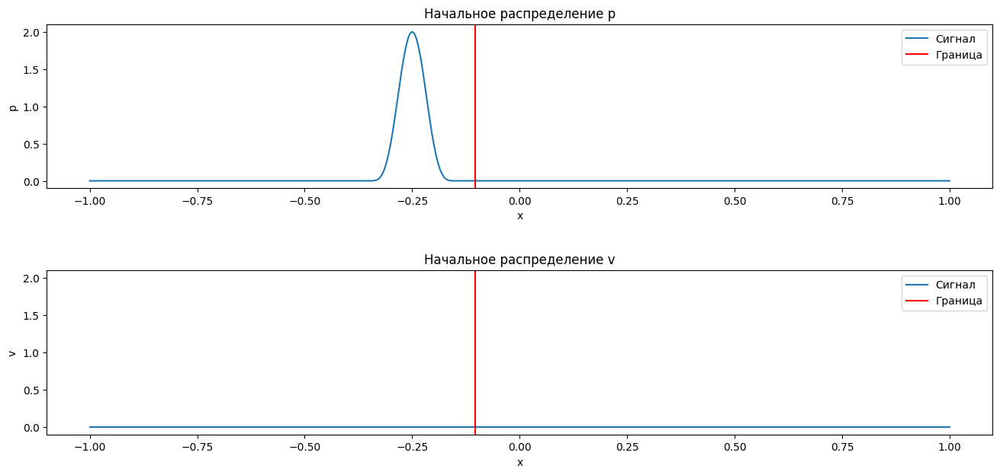

In [6]:
p_v_data = np.array([i.get_values() for i in initial_data])
x_data = [i.get_position() for i in initial_data]

# fig = plt.figure(figsize=(9, 6))
# values = ['p', 'v']
# axs = fig.subplots(1, 2)

# for ax, i in zip(axs, range(2)):
#     ax.plot(x_data, p_v_data[:, i], label='Сигнал', marker='o', markersize=1, mfc = 'r', mec = 'r')
#     ax.axvline(x = border_position, color = 'r', label = 'Граница')
#     ax.set_ylim(-0.1, 2.1)
#     # ax.set_xlim(-1.1, 1.1)
#     ax.set_xlim(-0.12, -0.08)
#     ax.legend()
#     ax.set_xlabel('x')
#     ax.set_ylabel(values[i])
#     ax.set_title(f'Начальное распределение {values[i]}')
# fig.suptitle('Начальные распределения')
# plt.show()

fig = plt.figure(figsize=(16, 7))
values = ['p', 'v']
axs = fig.subplots(2, 1)

for ax, i in zip(axs, range(2)):
    ax.plot(x_data, p_v_data[:, i], label='Сигнал')
    ax.set_ylim(-0.1, 2.1)
    ax.legend()
    ax.set_xlabel('x')
    ax.set_ylabel(values[i])
    ax.axvline(x=border_position, color='r', label='Граница')
    ax.set_title(f'Начальное распределение {values[i]}')
    ax.legend()
# fig.suptitle('Начальные распределения')
plt.subplots_adjust(hspace=0.5)
plt.show()

In [7]:
def from_alpha_beta_get_beta_c(alpha_beta: list[float], minus: bool = 0) -> list[float]:
    """
    На вход получает массив с параметрами среды.
    На выход возвращает массив [beta, c].
    """
    return [alpha_beta[1], ((-1) ** minus) * np.sqrt(np.multiply(*alpha_beta))]

# Аналитическое решение

In [8]:
""" Пока не понятно все-таки с инвариантами Риммана. Поэтому перепишем этот метод под инварианты, которые используются в статье
def analitic_get_initial_data_coords(t: float, edge: Edge, alpha_beta_1: list[float] = None, alpha_beta_2: list[float] = None) -> list[float]:
        '''
        Метод позволяет найти координаты начальных данных, откуда пришли характеристики.
        Возвращает массив из массивов, 
        Где первый массив из 2х точек, первая - левая, вторая - правая
        Второй - массив из 2х точек, из которых данные пришли на разрыв, а с разрыва одна из характеристик пришла в искомую точку.
        2 массива параметров понадобятся при случае, когда точка находится в области 2 или 3, т.к. придется проводить дополнительные вычисления для значений на границе
        '''
        border_pos = edge.get_border_pos()
        position = edge.get_area(t)
        # print(position)
        if position == 1 or position == 4:
            x_L = edge.get_position() -  np.sqrt(np.multiply(*edge.get_params())) * t
            x_R = edge.get_position() +  np.sqrt(np.multiply(*edge.get_params())) * t
            # Получаем константы, которые стоят в правой части в системе для нахождения решения в точке с 2х характеристик. Получаем массив
            # constants = np.matmul(np.array([edge.get_params()[1], np.sqrt(np.multiply(*edge.get_params()))]) , analitic_get_initial_data_values(x_L, x_R).transpose())
            constants = np.array([np.matmul(i, j) 
                                  for i, j in 
                                  zip(np.array([[edge.get_params()[1], np.sqrt(np.multiply(*edge.get_params()))], [edge.get_params()[1], -np.sqrt(np.multiply(*edge.get_params()))]]),
                                      analitic_get_initial_data_values(x_L, x_R))])
            # print(constants)
            # Решение системы уравнений
            new_values = solve(np.array([[edge.get_params()[1], np.sqrt(np.multiply(*edge.get_params()))], 
                                         [edge.get_params()[1], -np.sqrt(np.multiply(*edge.get_params()))]]),
                                           np.array(constants).reshape(-1, 1))
            return new_values
            
        elif position == 2:
            x_L = edge.get_position() -  np.sqrt(np.multiply(*edge.get_params())) * t
            t_tilda = t - (border_pos - edge.get_position()) / np.sqrt(np.multiply(*alpha_beta_1))
            x_tilda_L = border_pos - np.sqrt(np.multiply(*alpha_beta_1)) * t_tilda
            x_tilda_R = border_pos + np.sqrt(np.multiply(*alpha_beta_2)) * t_tilda
            # Вычисляем значения, которые придут на границу 
            border_characteristics = np.array(analitic_get_initial_data_values(x_tilda_L, x_tilda_R))
            constants_border = np.array([np.matmul(i, j) for i, j in zip(border_characteristics, [from_alpha_beta_get_beta_c(alpha_beta_1), from_alpha_beta_get_beta_c(alpha_beta_2, True)])]).transpose()
            # Вычисляем значения на шранице
            border_values = solve(np.array([from_alpha_beta_get_beta_c(alpha_beta_1), from_alpha_beta_get_beta_c(alpha_beta_2, True)]), constants_border).reshape(-1)
            # Повторяем все то же саме, но теперь для точки 
            # constants = np.matmul(from_alpha_beta_get_beta_c(edge.get_params()), np.array([analitic_get_initial_data_values(x_L, x_L)[0], border_values]).transpose())
            constants = np.array([np.matmul(i, j) 
                                  for i, j in 
                                  zip(np.array([analitic_get_initial_data_values(x_L, x_L)[0], border_values]), [from_alpha_beta_get_beta_c(alpha_beta_1), from_alpha_beta_get_beta_c(alpha_beta_2, True)])]).transpose()
            new_values = solve(np.array([from_alpha_beta_get_beta_c(edge.get_params()), from_alpha_beta_get_beta_c(edge.get_params(), True)]), np.array(constants).reshape(-1, 1))
            return new_values
        else:
            x_R = edge.get_position() +  np.sqrt(np.multiply(*edge.get_params())) * t
            t_tilda = t - (edge.get_position() - border_pos) / np.sqrt(np.multiply(*alpha_beta_2))
            x_tilda_L = border_pos - np.sqrt(np.multiply(*alpha_beta_1)) * t_tilda
            x_tilda_R = border_pos + np.sqrt(np.multiply(*alpha_beta_2)) * t_tilda
            # Вычисляем значения, которые придут на границу
            border_characteristics = np.array(analitic_get_initial_data_values(x_tilda_L, x_tilda_R))
            constants_border = np.array([np.matmul(i, j) for i, j in zip(border_characteristics, [from_alpha_beta_get_beta_c(alpha_beta_1), from_alpha_beta_get_beta_c(alpha_beta_2, True)])]).transpose()
            # Вычисляем значения на шранице
            border_values = solve(np.array([from_alpha_beta_get_beta_c(alpha_beta_1), from_alpha_beta_get_beta_c(alpha_beta_2, True)]), constants_border).reshape(-1)
            # Повторяем все то же саме, но теперь для точки 
            # constants = np.matmul(from_alpha_beta_get_beta_c(edge.get_params()), np.array([border_values, analitic_get_initial_data_values(x_R, x_R)[1]]).transpose())
            constants = np.array([np.matmul(i, j) 
                                  for i, j in 
                                  zip(np.array([ border_values, analitic_get_initial_data_values(x_R, x_R)[1]]), [from_alpha_beta_get_beta_c(alpha_beta_1), from_alpha_beta_get_beta_c(alpha_beta_2, True)])]).transpose()
            new_values = solve(np.array([from_alpha_beta_get_beta_c(edge.get_params()), from_alpha_beta_get_beta_c(edge.get_params(), True)]), np.array(constants).reshape(-1, 1))
            return new_values

"""
def analitic_get_initial_data(t: float, edge: Edge  = None, alpha_beta_1: list[float] = None, alpha_beta_2: list[float] = None, border_pos: float = None) -> list[float]:
    '''
    Метод позволяет найти аналитическое решение.
    Возвращает массив [p, v].
    Алгоритм будет следующим: переходим к переменным в инвариантах Риммана w+ и w-.
    Решаем для них уравнение переноса и потом возвращаеся обратно в переменные p, v.
    Если одна из характеристик попадает на границу, то для нее точно так же решаем задачу нахождения [p, v],
    а потом используем точку на характеристике как доп. точку.
    Тут будем использовать обозначения:
        Z = sqrt(alpha / beta) - акустический импеданс;
        R = [[Z, -Z], [1, 1]] - матрица собственных векторов.
    Параметры:
        t (float): Момент времени, для которого нужно рассчитать решение;
        edge (Edge): экземпляр класса ячейки;
        alpha_beta_1 (list[float]): массив с параметрами для ячеек до разрыва для расчета в области 2, если не нужен, то = None;
        alpha_beta_2 (list[float]): массив с параметрами для ячеек после разрыва для расчета в области 3, если не нужен, то = None.
        border (bool): флаг, нужен для пересчета значений на разрыве.
    '''
    
    if border_pos is not None:
        x_L = border_pos - np.sqrt(np.multiply(*alpha_beta_1)) * t
        x_R = border_pos + np.sqrt(np.multiply(*alpha_beta_2)) * t
        Z_L = np.sqrt(alpha_beta_1[0] / alpha_beta_1[1])
        Z_R = np.sqrt(alpha_beta_2[0] / alpha_beta_2[1])
        R_L = np.array([Z_L, -Z_L, 1, 1]).reshape(2, 2)
        R_R = np.array([Z_R, -Z_R, 1, 1]).reshape(2, 2)
        w_positive, w_negative = np.matmul(np.linalg.inv(R_L), np.array(analitic_get_left_initial_data_values(x_L)).reshape(-1, 1))[0],\
                                 np.matmul(np.linalg.inv(R_R), np.array(analitic_get_right_initial_data_values(x_R)).reshape(-1, 1))[1]
        p = 2 * (w_positive - w_negative) * Z_L * Z_R / (Z_L + Z_R)
        v = 2 * (Z_L * w_positive + Z_R * w_negative) / (Z_L + Z_R)
        return np.array([p, v]).reshape(-1 ,1)
    

    border_pos = edge.get_border_pos()
    position = edge.get_area(t)
    if position == 1 or position == 4: 
        alpha, beta = edge.get_params()
        Z = np.sqrt(alpha / beta)
        R = np.array([Z, -Z, 1, 1]).reshape(2, 2)
        x_L = edge.get_position() - np.sqrt(np.multiply(*edge.get_params())) * t
        x_R = edge.get_position() + np.sqrt(np.multiply(*edge.get_params())) * t
        w_positive, w_negative = np.matmul(np.linalg.inv(R), np.array(analitic_get_left_initial_data_values(x_L)).reshape(-1, 1))[0],\
                                 np.matmul(np.linalg.inv(R), np.array(analitic_get_right_initial_data_values(x_R)).reshape(-1, 1))[1]
        return np.matmul(R, np.array([w_positive, w_negative]).reshape(-1, 1))
    
    elif position == 2:
        alpha, beta = edge.get_params()
        Z = np.sqrt(alpha / beta)
        R = np.array([Z, -Z, 1, 1]).reshape(2, 2)
        x_L = edge.get_position() - np.sqrt(np.multiply(*edge.get_params())) * t
        # Далее находим точку, где хар-ка ппересекает границу
        t_tilda = t - (border_pos - edge.get_position()) / np.sqrt(np.multiply(*edge.get_params()))
        w_positive, w_negative = np.matmul(np.linalg.inv(R), np.array(analitic_get_left_initial_data_values(x_L)).reshape(-1, 1))[0],\
                                 np.matmul(np.linalg.inv(R), analitic_get_initial_data(t=t_tilda, alpha_beta_1=alpha_beta_1, alpha_beta_2=alpha_beta_2, border_pos=edge.get_border_pos()))[1]
        return np.matmul(R, np.array([w_positive, w_negative]).reshape(-1, 1))
    
    elif position == 3:
        alpha, beta = edge.get_params()
        Z = np.sqrt(alpha / beta)
        R = np.array([Z, -Z, 1, 1]).reshape(2, 2)
        x_R = edge.get_position() + np.sqrt(np.multiply(*edge.get_params())) * t
        # Далее находим точку, где хар-ка ппересекает границу
        t_tilda = t + (border_pos - edge.get_position()) / np.sqrt(np.multiply(*edge.get_params()))
        w_positive, w_negative = np.matmul(np.linalg.inv(R), analitic_get_initial_data(t=t_tilda, alpha_beta_1=alpha_beta_1, alpha_beta_2=alpha_beta_2, border_pos=edge.get_border_pos()))[0],\
                                 np.matmul(np.linalg.inv(R), np.array(analitic_get_right_initial_data_values(x_R)).reshape(-1, 1))[1]
        return np.matmul(R, np.array([w_positive, w_negative]).reshape(-1, 1))

    raise KeyError(f'Если дошло до этого момента, то произошла какая-то херня, Position = {position}')



def analitic_get_left_initial_data_values(x_L: float) -> np.ndarray:
    """
    Значения на характеристике с lambda = c
    Параметры:
        x_R (float): координата точки, где хар-ка пересекает координатную плоскость в нулевой момент времени
    """
    p_v_vector_L = []
    if x_L < -1:
        p_v_vector_L = [0, 0]
    if len(p_v_vector_L) == 0:
        p_v_vector_L = [initial_pressure_function(x_L), inintial_velocity_function(x_L)]

    return p_v_vector_L
    

def analitic_get_right_initial_data_values(x_R: float) -> np.ndarray:
    """
    Значения на характеристике с lambda = - c
    Параметры:
        x_R (float): координата точки, где хар-ка пересекает координатную плоскость в нулевой момент времени
    """
    p_v_vector_R = []
    if x_R > 1:
        p_v_vector_R = [0, 0]

    if len(p_v_vector_R) == 0:
        p_v_vector_R = [initial_pressure_function(x_R), inintial_velocity_function(x_R)]

    return p_v_vector_R      


In [73]:
# # Аналитическое решение
analitic_data = []
for edge in range(n_edges + 1):
    x_cord = L + edge * (R - L) / n_edges
    p = v = 0
    if x_cord == border_position:
        print('Yes')
    if x_cord < border_position:
        v = inintial_velocity_function(x_cord)
        p = initial_pressure_function(x_cord)
        analitic_data.append(Edge(x_cord, [p, v], alpha_1, beta_1, 0, border_position))
    else: 
        analitic_data.append(Edge(x_cord, [p, v], alpha_2, beta_2, 1, border_position))

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 7))
# fig, ax = plt.subplots()
ax1.set_xlim(-1, 1)
ax1.set_ylim(-0.1, 2.1)
ax1.set_xlabel('x')
ax1.set_ylabel('p')

ax2.set_xlim(-1, 1)
ax2.set_ylim(-1.1, 1.1)
ax2.set_xlabel('x')
ax2.set_ylabel('v')

p_v_data = np.array([i.get_values() for i in analitic_data])
x_data = [i.get_position() for i in analitic_data]


line1, = ax1.plot(x_data, p_v_data[:, 0], label='Сигнал')
ax1.axvline(x = border_position, color = 'r', label = 'Граница')

line2, = ax2.plot(x_data, p_v_data[:, 1], label='Сигнал')
ax2.axvline(x = border_position, color = 'r', label = 'Граница')

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Аналитическое решение')
time_template = 'time = %.2fs'
time_text = plt.text(0.05, 2.55, '', transform=ax.transAxes)
# time_text.set_text(time_template % (0))

# plt.show()
def init():
    time_text.set_text('')
    return line1, line2, time_text

# fig, ax = plt.subplots()
# ax.set_xlim(-0.25, 0.0)
# # ax.set_xlim(-1.1, 1.1)
# ax.set_ylim(-0.75, 1.1)
# # ax.set_ylim(-1.1, 1.1)
# ax.set_xlabel('x')
# ax.set_ylabel('v')
# ax.set_title('Аналитическое решение')
# line, = ax.plot([], [], lw=4, marker='o', markersize=1, mfc = 'r', mec = 'r')
# time_template = 'time = %.1fs'
# time_text = ax.text(0.05, 1.05, '', transform=ax.transAxes)
# def init():
#     line.set_data([], [])
#     time_text.set_text('')
#     return line, time_text

def animate(i):
    # prom_data = analitic_data.copy()
    x = np.array([edges.get_position() for edges in analitic_data])
    y = np.array([np.array(analitic_get_initial_data(i, edges, [alpha_1, beta_1], [alpha_2, beta_2])).reshape(-1) for edges in analitic_data])
    # print(i)
    line1.set_data(x, y[:, 0])
    line2.set_data(x, y[:, 1])

    for j in range(len(analitic_data)):
        analitic_data[j].set_values(np.array(y[j]))

    time_text.set_text(time_template % (i))   
     
    return line1, line2, time_text

plt.axvline(x = border_position, color = 'r', label = 'Граница')
ani = animation.FuncAnimation(fig, animate, np.arange(0, T, tau), interval=50000 * tau, blit=True, init_func=init)
plt.close()
HTML(ani.to_jshtml())

# Численное решение

In [9]:
def scheme_Rusanov_delta_positive(alpha_beta: float, edge_m_n2: Edge, edge_m_n1: Edge, edge_m: Edge, edge_m_p1: Edge):
    """
    Метод, реализующий схему Русанова 3-го порядка малости.
    Случай собственного значения > 0.
    Где delta = u_(i-1) - u_i
    Параметры:
        alpha_beta (float): параметры среды;
        edge_m_n2 (Edge): узел через один в обратную сторону относительно m-го в момент времени t;
        edge_m_n1 (Edge): предыдущий узел относительно m-го в момент времени t;
        edge_m (Edge): узел в момент времени t, для которого в момент времени t+1 ведется расчет;  
        edge_m_p1 (Edge): следующий узел относительно m-го в момент времени t;
    sound_velocity = sqrt(alpha * beta) сокрость звука, которая является собственным значением уравнений акустики
    число Куранта = lambda * tau / h = sound_velocity * tau / h
                o      t+1
                |
        o---o---o---o  t
       m-2 m-1  m   m+1
      m_n2 m_n1 m   m_p1
    """
    sound_velocity = np.sqrt(np.multiply(*alpha_beta))
    sigma = np.array(sound_velocity * tau / ((R - L) / n_edges))
    Z = np.sqrt(alpha_beta[0] / alpha_beta[1])
    R_matrix = np.array([Z, -Z, 1, 1]).reshape(2, 2)

    u_m_n2 = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m_n2.get_values()).reshape(-1, 1)).reshape(-1)[0]
    u_m_n1 = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m_n1.get_values()).reshape(-1, 1)).reshape(-1)[0]
    u_m = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m.get_values()).reshape(-1, 1)).reshape(-1)[0]
    u_m_p1 = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m_p1.get_values()).reshape(-1, 1)).reshape(-1)[0]

    delta_m = u_m_n1 - u_m
    delta_m_p1 = u_m - u_m_p1
    delta_m_n1 = u_m_n2 - u_m_n1

    
    u_next = u_m + 0.5 * sigma * (delta_m + delta_m_p1) + 0.5 * (sigma ** 2) * (delta_m - delta_m_p1) + (1/6) * sigma * (sigma ** 2 - 1) * (delta_m_n1 - 2 * delta_m + delta_m_p1)
    return u_next 



def scheme_Rusanov_delta_negative(alpha_beta: float, edge_m_n1: Edge, edge_m: Edge, edge_m_p1: Edge, edge_m_p2: Edge):
    """
    Метод, реализующий схему Русанова 3-го порядка малости.
    Случай собственного значения < 0. Схема симметрична отражена относительно edge_m.
    Где delta = u_(i+1) - u_i
    Параметры:
        alpha_beta (float): параметры среды;
        edge_m_n1 (Edge): предыдущий узел относительно m-го в момент времени t;
        edge_m (Edge): узел в момент времени t, для которого в момент времени t+1 ведется расчет;  
        edge_m_p1 (Edge): следующий узел относительно m-го в момент времени t;
        edge_m_p2 (Edge): узел через один вперед относительно m-го в момент времени t;
    sound_velocity = sqrt(alpha * beta) сокрость звука, которая является собственным значением уравнений акустики
    число Куранта = lambda * tau / h = sound_velocity * tau / h
            o          t+1
            |    
        o---o---o---o  t
       m-1  m  m+1 m+2
      m_n1  m m_p1 m_p2
    """
    sound_velocity = np.sqrt(np.multiply(*alpha_beta))
    sigma = np.array(sound_velocity * tau / ((R - L) / n_edges))
    Z = np.sqrt(alpha_beta[0] / alpha_beta[1])
    R_matrix = np.array([Z, -Z, 1, 1]).reshape(2, 2)

    
    u_m_n1 = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m_n1.get_values()).reshape(-1, 1)).reshape(-1)[1]
    u_m = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m.get_values()).reshape(-1, 1)).reshape(-1)[1]
    u_m_p1 = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m_p1.get_values()).reshape(-1, 1)).reshape(-1)[1]
    u_m_p2 = np.matmul(np.linalg.inv(R_matrix), np.array(edge_m_p2.get_values()).reshape(-1, 1)).reshape(-1)[1]

    delta_m = u_m_p1 - u_m
    delta_m_p1 = u_m - u_m_n1 
    delta_m_n1= u_m_p2 - u_m_p1

    u_next = u_m + 0.5 * sigma * (delta_m + delta_m_p1) + 0.5 * (sigma ** 2) * (delta_m - delta_m_p1) + (1/6) * sigma * (sigma ** 2 - 1) * (delta_m_n1 - 2 * delta_m + delta_m_p1)
    return u_next 

In [10]:
def velocity_polinom(edge_n2: Edge, edge_n1: Edge, edge_p1: Edge, edge_p2: Edge, alpha_beta_1: list[float], alpha_beta_2: list[float], border_pos: float) -> np.ndarray:
    """
    Функция для апроксимации 2х наиболее близских точек от разрыва с каждой стороны.
    Строит полиномы и возвращает коэффициенты этих полиномов.
    Параметры:
        alpha_beta_1 (list[float]): массив параметров стреды до разрыва, хранится ввиде [alpha, beta]
        alpha_beta_2 (list[float]): массив параметров стреды после разрыва, хранится ввиде [alpha, beta]
        edge_n2 (Edge): Экземпяр кслааса для второй точки от границы влево
        edge_n1 (Edge): Экземпяр кслааса для первой точки от границы влево
        edge_p1 (Edge): Экземпяр кслааса для первой точки от границы вправо
        edge_p2 (Edge): Экземпяр кслааса для второй точки от границы вправо
        border_pos (float): позиция разрыва

          |
          |
    o---o-|-o---o
    n2 n1 | p1  p2
          |
        border

    Получаем полином для скорости.
    Полином имеет вид:
        Q(x) = a * (x - x_border) ** 3 + b * (x - x_border) ** 2 + c * (x - x_border) + d
    Будем решать систему для 8 неизвестных с 8ю уравнениями, где неизвестные:
    a1, b1, c1, d1, a2, b2, c2, d2.
    А уравнени системы:
        первые 4 - полученны из значений Q(x),
        А второые 4 - получены из соотношений коэффициентов
    """
    delta_x_n2 = edge_n2.get_position() - border_pos
    delta_x_n1 = edge_n1.get_position() - border_pos
    delta_x_p1 = edge_p1.get_position() - border_pos
    delta_x_p2 = edge_p2.get_position() - border_pos

    v_n2 = edge_n2.get_values()[1]
    v_n1 = edge_n1.get_values()[1]
    v_p1 = edge_p1.get_values()[1] 
    v_p2 = edge_p2.get_values()[1]

    f = np.array([v_n2, v_n1, v_p1, v_p2, 0, 0, 0, 0]).reshape(-1, 1)
    A = np.array([delta_x_n2 ** 3, delta_x_n2 ** 2, delta_x_n2, 1, 0, 0, 0, 0,
                  delta_x_n1 ** 3, delta_x_n1 ** 2, delta_x_n1, 1, 0, 0, 0, 0,
                  0, 0, 0, 0, delta_x_p1 ** 3, delta_x_p1 ** 2, delta_x_p1, 1,
                  0, 0, 0, 0, delta_x_p2 ** 3, delta_x_p2 ** 2, delta_x_p2, 1,
                  0, 0, 0, 1, 0, 0, 0, -1,
                  0, 0, alpha_beta_1[0], 0, 0, 0, -alpha_beta_2[0], 0,
                  0, np.multiply(*alpha_beta_1), 0, 0, 0, -np.multiply(*alpha_beta_2), 0, 0,
                  np.multiply(*alpha_beta_1) * alpha_beta_1[0], 0, 0, 0, -np.multiply(*alpha_beta_2) * alpha_beta_2[0], 0, 0, 0]).reshape(8, 8)
    
    return solve(A, f)

def presure_polinom(edge_n2: Edge, edge_n1: Edge, edge_p1: Edge, edge_p2: Edge, alpha_beta_1: list[float], alpha_beta_2: list[float], border_pos: float) -> np.ndarray:
    """
    Функция для апроксимации 2х наиболее близских точек от разрыва с каждой стороны.
    Строит полиномы и возвращает коэффициенты этих полиномов.
    Параметры:
        alpha_beta_1 (list[float]): массив параметров стреды до разрыва, хранится ввиде [alpha, beta]
        alpha_beta_2 (list[float]): массив параметров стреды после разрыва, хранится ввиде [alpha, beta]
        edge_n2 (Edge): Экземпяр кслааса для второй точки от границы влево
        edge_n1 (Edge): Экземпяр кслааса для первой точки от границы влево
        edge_p1 (Edge): Экземпяр кслааса для первой точки от границы вправо
        edge_p2 (Edge): Экземпяр кслааса для второй точки от границы вправо
        border_pos (float): позиция разрыва
        
          |
          |
    o---o-|-o---o
    n2 n1 | p1  p2
          |
        border
    Получаем полином для давления.
    Полином имеет вид:
        P(x) = gamma * (x - x_border) ** 3 + delta * (x - x_border) ** 2 + psi * (x - x_border) + phi
    Будем решать систему для 8 неизвестных с 8ю уравнениями, где неизвестные:
    gamma1, delta1, psi1, phi1, gamma2, delta2, psi2, phi2.
    А уравнени системы:
        первые 4 - полученны из значений P(x),
        А второые 4 - получены из соотношений коэффициентов
    """
    delta_x_n2 = edge_n2.get_position() - border_pos
    delta_x_n1 = edge_n1.get_position() - border_pos
    delta_x_p1 = edge_p1.get_position() - border_pos
    delta_x_p2 = edge_p2.get_position() - border_pos

    p_n2 = edge_n2.get_values()[0]
    p_n1 = edge_n1.get_values()[0]
    p_p1 = edge_p1.get_values()[0] 
    p_p2 = edge_p2.get_values()[0]

    f = np.array([p_n2, p_n1, p_p1, p_p2, 0, 0, 0, 0]).reshape(-1, 1)
    A = np.array([delta_x_n2 ** 3, delta_x_n2 ** 2, delta_x_n2, 1, 0, 0, 0, 0,
                  delta_x_n1 ** 3, delta_x_n1 ** 2, delta_x_n1, 1, 0, 0, 0, 0,
                  0, 0, 0, 0, delta_x_p1 ** 3, delta_x_p1 ** 2, delta_x_p1, 1,
                  0, 0, 0, 0, delta_x_p2 ** 3, delta_x_p2 ** 2, delta_x_p2, 1,
                  0, 0, 0, 1, 0, 0, 0, -1,
                  0, 0, alpha_beta_1[1], 0, 0, 0, -alpha_beta_2[1], 0,
                  0, np.multiply(*alpha_beta_1), 0, 0, 0, -np.multiply(*alpha_beta_2), 0, 0,
                  np.multiply(*alpha_beta_1) * alpha_beta_1[1], 0, 0, 0, -np.multiply(*alpha_beta_2) * alpha_beta_2[1], 0, 0, 0]).reshape(8, 8)
    
    return solve(A, f)


In [11]:
def get_poloinomial_edges(edge_data: list[Edge], P_polinom: np.ndarray, Q_polinom: np.ndarray, border_pos: float, alpha_beta: list[float]) -> list[Edge]:
    """
    Функция, которая принимает массив ячеек, 
    значнеия которых нужно пересчиать согласно значениям полинома.
    Параметры:
        edge_data (list[Edge]): массив ячеек, которые необходимо пересчитать согласно полиному
        P_polinom (np.ndarray): коэффициенты полинома для давления, НО ИХ НУЖНО ИНВЕРТИРОВАТЬ, чтобы формула была правильной: [a, b, c, d] -> [d, c, b, a]
        Q_polinom (np.ndarray): коэффициенты полинома для давления, НО ИХ НУЖНО ИНВЕРТИРОВАТЬ, чтобы формула была правильной: [a, b, c, d] -> [d, c, b, a]
        border_pos (float): координаты разрыва, для которого происходит расчет
        alpha_beta (list[float]): параметры среды, но они не совпадают с теми, которые у этих ячеек ,а берутся те параметры, которые находятся за разрывом
    """
    P_reversed_polinom = list(reversed(P_polinom))
    Q_reversed_polinom = list(reversed(Q_polinom))
    delta_x_data = []
    new_edges_data = []
    for edge in edge_data:
        delta_x_data.append(edge.get_position() - border_pos)

    for i in range(len(edge_data)):
        P_value = 0
        Q_value = 0
        for j, k in zip(range(len(P_polinom)), range(len(Q_polinom))):
            P_value += P_reversed_polinom[j] * (delta_x_data[i] ** j)
            Q_value += Q_reversed_polinom[k] * (delta_x_data[i] ** k)
        new_edges_data.append(Edge(x=edge_data[i].get_position(), values=[P_value, Q_value], alpha=alpha_beta[0], beta=alpha_beta[1], border=edge_data[i].get_border_status(), border_pos=border_pos))
    return new_edges_data


In [12]:
def get_poloinomial_values(P_polinom: np.ndarray, Q_polinom: np.ndarray, position: float, border_pos: float) -> list[float]:
    """
    Расчет по коэффициентам полинома значнеия в точке.
    Возвращает пересчитанный вектор [p, v]
    Параметры:
        P_polinom (np.ndarray): коэффициенты полинома для давления, НО ИХ НУЖНО ИНВЕРТИРОВАТЬ, чтобы формула была правильной: [a, b, c, d] -> [d, c, b, a]
        Q_polinom (np.ndarray): коэффициенты полинома для давления, НО ИХ НУЖНО ИНВЕРТИРОВАТЬ, чтобы формула была правильной: [a, b, c, d] -> [d, c, b, a]
        position (float): Координаты точки расчета
        border_pos (float): координаты разрыва, для которого происходит расчет
    """
    P_reversed_polinom = list(reversed(P_polinom.reshape(-1)))
    Q_reversed_polinom = list(reversed(Q_polinom.reshape(-1)))
    delta_x = position - border_pos

    P_value = 0
    Q_value = 0
    for j, k in zip(range(len(P_polinom)), range(len(Q_polinom))):
        P_value += P_reversed_polinom[j] * (delta_x ** j)
        Q_value += Q_reversed_polinom[k] * (delta_x ** k)

    return [P_value, Q_value]

# Вариант, где полином строиться только на 4х точках, которые попарно находятся по сторонам разрыва. Далее эти полиномы просто эксплуатируются для точек на разрыве, а не перестраиваются заново для каждого случая

In [13]:
# # Численное решение

numerical_data = []
analitic_data = []
for edge in range(n_edges + 1):
    x_cord = L + edge * (R - L) / n_edges
    p = v = 0
    if x_cord == border_position:
        print('Yes')
    if x_cord < border_position:
        v = inintial_velocity_function(x_cord)
        p = initial_pressure_function(x_cord)
        numerical_data.append(Edge(x_cord, [p, v], alpha_1, beta_1, 0, border_position))
        analitic_data.append(Edge(x_cord, [p, v], alpha_1, beta_1, 0, border_position))
    else: 
        numerical_data.append(Edge(x_cord, [p, v], alpha_2, beta_2, 1, border_position))
        analitic_data.append(Edge(x_cord, [p, v], alpha_2, beta_2, 1, border_position))

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 7))
# fig, ax = plt.subplots()
ax1.set_xlim(-1, 1)
ax1.set_ylim(-0.1, 2.1)
ax1.set_xlabel('x')
ax1.set_ylabel('p')

ax2.set_xlim(-1, 1)
ax2.set_ylim(-1.1, 1.1)
ax2.set_xlabel('x')
ax2.set_ylabel('v')

p_v_data = np.array([i.get_values() for i in numerical_data])
x_data = [i.get_position() for i in numerical_data]

analitic_line1, = ax1.plot(x_data, p_v_data[:, 0], label='Аналитическое')
line1, = ax1.plot(x_data, p_v_data[:, 0], linestyle='-.', color='red', label='Численное')
ax1.axvline(x = border_position, color = 'r', label = 'Граница')

analitic_line2, = ax2.plot(x_data, p_v_data[:, 1], label='Аналитическое')
line2, = ax2.plot(x_data, p_v_data[:, 1], linestyle='-.', color='red', label='Численное')
ax2.axvline(x = border_position, color = 'r', label = 'Граница')

ax1.legend()
ax2.legend()
# fig, ax = plt.subplots()
# ax.set_xlim(-1, 1)
# # ax.set_ylim(-0.1, 2.1)
# ax.set_ylim(-1.1, 1.1)
# ax.set_xlabel('x')
# ax.set_ylabel('v')
plt.suptitle('Численное решение')
# line, = ax.plot([], [], lw=4)
time_template = 'time = %.2fs'
time_text = plt.text(0.05, 2.55, '', transform=ax.transAxes)
def init():
    # line.set_data([], [])
    time_text.set_text('')
    return line1, line2, time_text

def animate(i):
    x = np.array([edges.get_position() for edges in numerical_data])
    if i == 0:
        # y = np.array([edges.get_values() for edges in numerical_data])
        # line1.set_data(x, y[:, 1])
        pass
    else: 
        """
    
        АНАЛИТИЧЕСКИЙ РАСЧЕТ
        
        
        """

        y_analitic = np.array([np.array(analitic_get_initial_data(i, edges, [alpha_1, beta_1], [alpha_2, beta_2])).reshape(-1) for edges in analitic_data])
        analitic_line1.set_data(x, y_analitic[:, 0])
        analitic_line2.set_data(x, y_analitic[:, 1])
        
        """
    
        ЧИСЛЕННЫЙ РАСЧЕТ
        
        
        """
        y = []
        # P_polinom = None 
        # Q_polinom = None 
        queue = deque()
        for j in range(len(numerical_data)):
            # Проверка на граничные узлы сетки. Там расчет не производится.
            if j > 1 and j < len(numerical_data) - 2: 
                # Фиксируем скачек значений параметров
                if numerical_data[j + 2].get_params() != numerical_data[j + 1].get_params():
                    border_flag = 4 # При срабатывании триггера, он становиться равным числу точек, для которых расчет производится через полиномы
                    # Строим полином для скорости. Коэффициенты полинома Q
                    Q_polinom = velocity_polinom(edge_n2=numerical_data[j],
                                                edge_n1=numerical_data[j + 1], 
                                                edge_p1=numerical_data[j + 2], 
                                                edge_p2=numerical_data[j + 3], 
                                                alpha_beta_1=numerical_data[j + 1].get_params(), 
                                                alpha_beta_2=numerical_data[j + 2].get_params(), 
                                                border_pos=border_position)
                    # Строим полином для давления. Коэффициенты полинома P 
                    P_polinom = presure_polinom(edge_n2=numerical_data[j],
                                                edge_n1=numerical_data[j + 1], 
                                                edge_p1=numerical_data[j + 2], 
                                                edge_p2=numerical_data[j + 3], 
                                                alpha_beta_1=numerical_data[j + 1].get_params(), 
                                                alpha_beta_2=numerical_data[j + 2].get_params(), 
                                                border_pos=border_position)
                    # Пересчитанные значения для 2-х ячеек за границей 
                    left_edges = get_poloinomial_edges(edge_data=[numerical_data[j + 2], numerical_data[j + 3]], 
                                                    P_polinom=P_polinom[:4], 
                                                    Q_polinom=Q_polinom[:4], 
                                                    border_pos=numerical_data[j + 1].get_border_pos(),
                                                    alpha_beta=numerical_data[j + 1].get_params())
                    # Пересчитанные значения для 2-х ячеек перед границей
                    right_edges = get_poloinomial_edges(edge_data=[numerical_data[j], numerical_data[j + 1]], 
                                                        P_polinom=P_polinom[4:], 
                                                        Q_polinom=Q_polinom[4:], 
                                                        border_pos=numerical_data[j + 1].get_border_pos(),
                                                        alpha_beta=numerical_data[j + 2].get_params())
                    # Создадим очередь для расчета значений на разрыве. В очередь будем складывать массивы из 5 значнеий для расчета. Таких массивов будет 4 штуки.
                    # Во 2м и 3м массиве мы добавим еще полученные полиномы, т.к. нам понадобятся эти значения, если характеристики попадают на границу
                    queue.append([numerical_data[j - 2], numerical_data[j - 1], numerical_data[j], numerical_data[j + 1], left_edges[0]])
                    queue.append([numerical_data[j - 1], numerical_data[j], numerical_data[j + 1], left_edges[0], left_edges[1], Q_polinom[:], P_polinom[:]])
                    queue.append([right_edges[0], right_edges[1], numerical_data[j + 2], numerical_data[j + 3], numerical_data[j + 4], Q_polinom[:], P_polinom[:]])
                    queue.append([right_edges[1], numerical_data[j + 2], numerical_data[j + 3], numerical_data[j + 4], numerical_data[j + 5]])
                # Проверка на то, пустая ли очередь для расчета граничных значений
                if queue:
                    # Как только мы рассмотрим все случаи, очередь станет пустой, и цикл не будет заходить в этот блок
                    edge_list = queue.popleft()
                    # Слудай, когда только один узел находится на другой стороне от разрыва, чем остальные 4
                    if len(edge_list) == 5:
                        alpha, beta = numerical_data[j].get_params()
                        Z = np.sqrt(alpha / beta)
                        R_matrix = np.array([Z, -Z, 1, 1]).reshape(2, 2)
                        w_positive = scheme_Rusanov_delta_positive(numerical_data[j].get_params(), edge_list[0], edge_list[1], edge_list[2], edge_list[3])
                        w_negative = scheme_Rusanov_delta_negative(numerical_data[j].get_params(), edge_list[1], edge_list[2], edge_list[3], edge_list[4])
                        y.append(list(np.matmul(R_matrix, np.array([w_positive, w_negative]).reshape(-1, 1)).reshape(-1)))
                    # Случай, когда 2 узла находятся по другую сторону разрыва из 5 рассматриваемых узлов
                    else:
                        P_polinom = edge_list.pop()
                        Q_polinom = edge_list.pop()
                        # Теперь нужно проверить, попадает ли характеристика на границу или нет. Для этого найдем время пересечения характеристики границы. ЕСли оно в промежутке [0, tau], то будем брать значение с границы
                        x_pos = numerical_data[j].get_position()
                        # Проверка, что характеристика lambda не пересекает границу
                        w_positive_final = 0
                        w_negative_final = 0
                        if len(queue) < 2 and (x_pos - np.sqrt(np.multiply(*numerical_data[j].get_params())) * tau < numerical_data[j].get_border_pos()):
                            t_tilda = tau + (numerical_data[j].get_border_pos() - numerical_data[j].get_position()) / np.sqrt(np.multiply(*numerical_data[j].get_params()))
                            # Находим точки, из которых приходят характеристики на границу
                            x_L = numerical_data[j].get_border_pos() - np.sqrt(np.multiply(*numerical_data[j - 1].get_params())) * t_tilda
                            x_R = numerical_data[j].get_border_pos() + np.sqrt(np.multiply(*numerical_data[j].get_params())) * t_tilda
                            #  Пересчет значений
                            values_L = get_poloinomial_values(P_polinom=P_polinom[:4], Q_polinom=Q_polinom[:4], position=x_L, border_pos=numerical_data[j].get_border_pos())
                            values_R = get_poloinomial_values(P_polinom=P_polinom[4:], Q_polinom=Q_polinom[4:], position=x_R, border_pos=numerical_data[j].get_border_pos())
                            
                            alpha, beta = numerical_data[j].get_params()
                            Z_R = np.sqrt(alpha / beta)
                            alpha, beta = numerical_data[j - 1].get_params()
                            Z_L = np.sqrt(alpha / beta)
                            R_matrix_R = np.array([Z_R, -Z_R, 1, 1]).reshape(2, 2)
                            R_matrix_L = np.array([Z_L, -Z_L, 1, 1]).reshape(2, 2)
                            #  Пресчет полученных значений в инварианты Риммана
                            w_positive = np.matmul(np.linalg.inv(R_matrix_L), np.array(values_L).reshape(-1, 1))[0]
                            w_negative = np.matmul(np.linalg.inv(R_matrix_R), np.array(values_R).reshape(-1, 1))[1]

                            w_positive_final = np.matmul(np.linalg.inv(R_matrix_R), np.array([2 * (Z_L * Z_R) * (w_positive - w_negative) / (Z_L + Z_R), 2 * (Z_L * w_positive + Z_R * w_negative) / (Z_L + Z_R)]).reshape(-1, 1)).reshape(-1)[0]
                        else:
                            w_positive_final = scheme_Rusanov_delta_positive(numerical_data[j].get_params(), edge_list[0], edge_list[1], edge_list[2], edge_list[3])
                        
                        # Проверка, что характеристика -lambda не пересекает границу
                        if len(queue) > 1 and (x_pos + np.sqrt(np.multiply(*numerical_data[j].get_params())) * tau > numerical_data[j].get_border_pos()):
                            t_tilda = tau - (numerical_data[j].get_border_pos() - numerical_data[j].get_position()) / np.sqrt(np.multiply(*numerical_data[j].get_params()))
                            # Находим точки, из которых приходят характеристики на границу
                            x_L = numerical_data[j].get_border_pos() - np.sqrt(np.multiply(*numerical_data[j].get_params())) * t_tilda
                            x_R = numerical_data[j].get_border_pos() + np.sqrt(np.multiply(*numerical_data[j + 1].get_params())) * t_tilda
                            #  Пересчет значений
                            values_L = get_poloinomial_values(P_polinom=P_polinom[:4], Q_polinom=Q_polinom[:4], position=x_L, border_pos=numerical_data[j].get_border_pos())
                            values_R = get_poloinomial_values(P_polinom=P_polinom[4:], Q_polinom=Q_polinom[4:], position=x_R, border_pos=numerical_data[j].get_border_pos())

                            alpha, beta = numerical_data[j].get_params()
                            Z_L = np.sqrt(alpha / beta)
                            alpha, beta = numerical_data[j + 1].get_params()
                            Z_R = np.sqrt(alpha / beta)

                            R_matrix_R = np.array([Z_R, -Z_R, 1, 1]).reshape(2, 2)
                            R_matrix_L = np.array([Z_L, -Z_L, 1, 1]).reshape(2, 2)
                            #  Пресчет полученных значений в инварианты Риммана
                            w_positive = np.matmul(np.linalg.inv(R_matrix_L), np.array(values_L).reshape(-1, 1))[0]
                            w_negative = np.matmul(np.linalg.inv(R_matrix_R), np.array(values_R).reshape(-1, 1))[1]

                            w_negative_final = np.matmul(np.linalg.inv(R_matrix_L), np.array([2 * (Z_L * Z_R) * (w_positive - w_negative) / (Z_L + Z_R), 2 * (Z_L * w_positive + Z_R * w_negative) / (Z_L + Z_R)]).reshape(-1, 1)).reshape(-1)[1]
                        else:
                            w_negative_final = scheme_Rusanov_delta_negative(numerical_data[j].get_params(), edge_list[1], edge_list[2], edge_list[3], edge_list[4])

                        alpha, beta = numerical_data[j].get_params()
                        Z = np.sqrt(alpha / beta)
                        R_matrix = np.array([Z, -Z, 1, 1]).reshape(2, 2)
                        y.append(list(np.array(np.matmul(R_matrix, np.array([w_positive_final, w_negative_final]).reshape(-1, 1))).reshape(-1)))
                else:
                    alpha, beta = numerical_data[j].get_params()
                    Z = np.sqrt(alpha / beta)
                    R_matrix = np.array([Z, -Z, 1, 1]).reshape(2, 2)
                    w_positive = scheme_Rusanov_delta_positive(numerical_data[j].get_params(), numerical_data[j - 2], numerical_data[j - 1], numerical_data[j], numerical_data[j + 1])
                    w_negative = scheme_Rusanov_delta_negative(numerical_data[j].get_params(), numerical_data[j - 1], numerical_data[j], numerical_data[j + 1], numerical_data[j + 2])
                    y.append(np.matmul(R_matrix, np.array([w_positive, w_negative]).reshape(-1, 1)).reshape(-1))
                
            else:
                y.append([0, 0])
        
        y = np.array(y)
        line1.set_data(x, y[:, 0])
        line2.set_data(x, y[:, 1])
        for j in range(len(numerical_data)):
            numerical_data[j].set_values(np.array(y[j]))
    time_text.set_text(time_template % (i))    
    return line1, line2, time_text

plt.axvline(x = border_position, color = 'r', label = 'Граница')

ani = animation.FuncAnimation(fig, animate, np.arange(0, T, tau), interval=50000 * tau, blit=True, init_func=init)
plt.subplots_adjust(hspace=0.5)
plt.close()
HTML(ani.to_jshtml())
# writergif = animation.PillowWriter(fps=30) 
# ani.save('one_polinom_one_border.gif', writer=writergif, progress_callback=lambda i, n: print(f'Saving frame {i}/{n}'))
